Animation size has reached 20990060 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


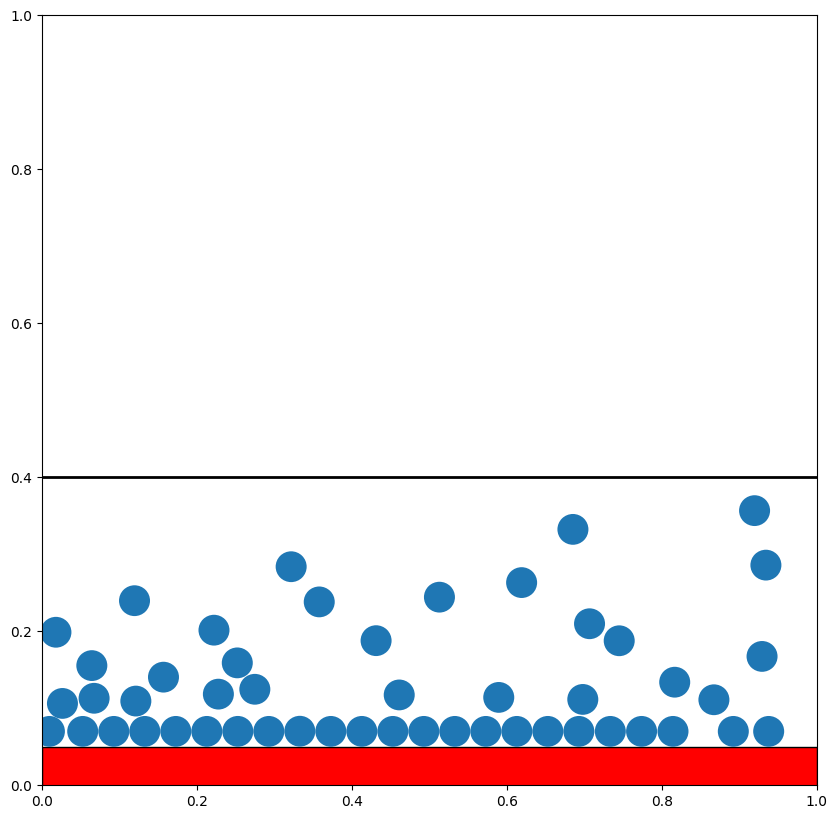

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Circle, Rectangle
from IPython.display import HTML

# Parámetros de la simulación
num_rows = 10
num_cols = 50
n_sets = 1
u_0 = 0.1
dt = 0.05
steps = 2000
radius = 0.02
top_wall_height = num_rows * 2 * radius

# Cálculo del periodo de entrada
entry_period = int((num_cols * 2 * radius) / (u_0 * dt))

# Nueva pared horizontal
wall_y = 0
wall_thickness = 0.1
wall_start_x = 0
wall_end_x = 1.0
sticky_wall = True  # Parámetro para controlar si la pared es adhesiva

def create_particle_group():
    positions = np.zeros((num_rows * num_cols, 2))
    velocities = np.zeros((num_rows * num_cols, 2))
    for col in range(num_cols):
        for row in range(num_rows):
            idx = col * num_rows + row
            positions[idx, 0] = -2 * radius * (num_cols - col)
            positions[idx, 1] = row * 2 * radius + radius
            velocities[idx, 0] = u_0
    return positions, velocities

all_positions = []
all_velocities = []

def handle_collisions(positions, velocities):
    N = len(positions)
    for i in range(N):
        # Colisión con paredes
        if positions[i, 1] <= radius:  # Pared inferior
            positions[i, 1] = radius
            velocities[i] = [0, 0]
        elif positions[i, 1] >= top_wall_height - radius:  # Pared superior
            positions[i, 1] = top_wall_height - radius
            velocities[i, 1] *= -1
        if positions[i, 0] >= 1 - radius:  # Pared derecha (salida)
            positions[i] = [-1, -1]
            velocities[i] = [0, 0]
        
        # Colisión con la nueva pared horizontal
        if wall_start_x <= positions[i, 0] <= wall_end_x and \
           wall_y - wall_thickness/2 - radius <= positions[i, 1] <= wall_y + wall_thickness/2 + radius:
            if sticky_wall:
                positions[i, 1] = wall_y + wall_thickness/2 + radius
                velocities[i] = [0, 0]  # Se pega a la pared
            else:
                if positions[i, 1] < wall_y:
                    positions[i, 1] = wall_y - wall_thickness/2 - radius
                else:
                    positions[i, 1] = wall_y + wall_thickness/2 + radius
                velocities[i, 1] *= -1  # Rebote elástico

        # Colisiones entre partículas
        for j in range(i+1, N):
            if positions[i, 0] < 0 or positions[j, 0] < 0:
                continue
            diff = positions[i] - positions[j]
            dist = np.linalg.norm(diff)
            if dist < 2*radius:
                overlap = 2*radius - dist
                positions[i] += overlap/2 * diff/dist
                positions[j] -= overlap/2 * diff/dist

                normal = diff / dist
                v_rel = velocities[i] - velocities[j]
                v_normal = np.dot(v_rel, normal) * normal
                velocities[i] -= v_normal
                velocities[j] += v_normal

    mask = positions[:, 0] < 1
    return positions[mask], velocities[mask]

fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)

particles = []
wall = Rectangle((wall_start_x, wall_y - wall_thickness/2), wall_end_x - wall_start_x, wall_thickness, 
                 facecolor='red', edgecolor='black')
ax.add_patch(wall)

top_wall = plt.Line2D([0, 1], [top_wall_height, top_wall_height], color='black', linewidth=2)
ax.add_line(top_wall)

def update(frame):
    global all_positions, all_velocities, particles
    
    if frame % entry_period == 0 and len(all_positions) < n_sets:
        new_positions, new_velocities = create_particle_group()
        all_positions.append(new_positions)
        all_velocities.append(new_velocities)
    
    for i in range(len(all_positions)):
        all_positions[i] += all_velocities[i] * dt
        all_positions[i], all_velocities[i] = handle_collisions(all_positions[i], all_velocities[i])
    
    for particle in particles:
        particle.remove()
    particles.clear()
    
    for group in all_positions:
        for pos in group:
            if 0 <= pos[0] < 1:
                particle = Circle((pos[0], pos[1]), radius)
                ax.add_patch(particle)
                particles.append(particle)
    
    return particles + [wall, top_wall]

anim = FuncAnimation(fig, update, frames=steps, interval=50, blit=True)

HTML(anim.to_jshtml())


Animation size has reached 21012658 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


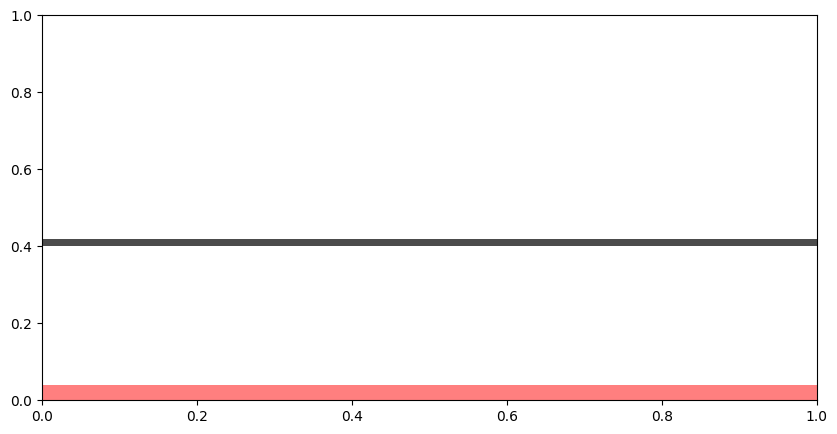

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Circle, Rectangle
from IPython.display import HTML

# Parámetros de la simulación
num_rows = 10         # Número de filas de partículas
num_cols = 25        # Número de columnas de partículas
u_0 = 0.1            # Velocidad inicial en x
dt = 0.05            # Paso de tiempo
steps = 2000         # Número de pasos de simulación
radius = 0.02        # Radio de las partículas
L, H = 1.0, 1.0      # Dimensiones del dominio (tubería)
x_stick = 0.0        # Valor de x donde la pared inferior es pegajosa
top_wall_y = num_rows * radius * 2  # Altura de la pared superior


# Inicialización de las posiciones y velocidades de las partículas
def create_particles():
    positions = np.zeros((num_rows * num_cols, 2))
    velocities = np.zeros((num_rows * num_cols, 2))
    stuck = np.zeros(num_rows * num_cols, dtype=bool)  # Estado pegado (False por defecto)
    for row in range(num_rows):
        for col in range(num_cols):
            idx = row * num_cols + col
            positions[idx, 0] = -2 * radius * (num_cols - col)  # Fuera del dominio inicial (x < 0)
            positions[idx, 1] = row * 2 * radius + radius       # Distribuidas en filas (y aumenta por fila)
            velocities[idx, 0] = u_0                           # Velocidad inicial en x
    return positions, velocities, stuck

positions, velocities, stuck = create_particles()

# Función para manejar las restricciones del "hilo" (mantener distancias fijas)
def apply_constraints(positions):
    for row in range(num_rows):
        for col in range(num_cols):
            idx = row * num_cols + col

            # Conexión horizontal (con la partícula a la derecha)
            if col < num_cols - 1:
                right_idx = idx + 1
                delta_pos = positions[right_idx] - positions[idx]
                dist = np.linalg.norm(delta_pos)
                if dist > 2 * radius:  # Ajustar si la distancia excede el límite permitido
                    correction = (dist - 2 * radius) / dist * delta_pos / 2
                    positions[idx] += correction
                    positions[right_idx] -= correction

            # Conexión vertical (con la partícula arriba)
            if row < num_rows - 1:
                up_idx = idx + num_cols
                delta_pos = positions[up_idx] - positions[idx]
                dist = np.linalg.norm(delta_pos)
                if dist > 2 * radius:  # Ajustar si la distancia excede el límite permitido
                    correction = (dist - 2 * radius) / dist * delta_pos / 2
                    positions[idx] += correction
                    positions[up_idx] -= correction

# Manejo de colisiones y movimiento
def handle_collisions(positions, velocities, stuck):
    N = len(positions)
    for i in range(N):
        if stuck[i]:  
            continue  # Si la partícula está pegada, no se mueve ni interactúa

        # Actualización de la posición
        positions[i] += velocities[i] * dt

        # Colisión con la pared inferior (se pega si x > x_stick)
        if positions[i, 1] <= radius:
            positions[i, 1] = radius
            if positions[i, 0] >= x_stick:  
                stuck[i] = True             # La partícula se pega a la pared inferior
                velocities[i] = [0, 0]      # Detenemos completamente su movimiento

        # Colisión con la pared superior (rebote elástico)
        if positions[i, 1] >= top_wall_y:
            positions[i, 1] = top_wall_y
            velocities[i, 1] *= -1

        # Colisión con otras partículas (colisiones elásticas)
        for j in range(i + 1, N):
            if stuck[j]:  
                continue  # Las partículas pegadas no interactúan con otras

            diff = positions[j] - positions[i]
            dist = np.linalg.norm(diff)
            if dist < 2 * radius:  # Si hay colisión
                overlap = 2 * radius - dist

                # Reposicionar para evitar superposición
                normal = diff / dist
                positions[i] -= overlap / 2 * normal
                positions[j] += overlap / 2 * normal

                # Intercambio de momento lineal (colisión elástica)
                delta_v = velocities[j] - velocities[i]
                v_normal = np.dot(delta_v, normal) * normal
                velocities[i] += v_normal
                velocities[j] -= v_normal

    apply_constraints(positions)

# Configuración de la animación
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_xlim(0, L)
ax.set_ylim(0, H)

particles_patches = []
for _ in range(num_rows * num_cols):
    particle_patch = Circle((0, 0), radius=radius, facecolor='blue', edgecolor='black')
    particles_patches.append(particle_patch)
    ax.add_patch(particle_patch)

# Pared adhesiva inferior (visualización)
sticky_wall_patch = Rectangle((x_stick, 0), L - x_stick, radius * 2,
                              facecolor='red', alpha=0.5)
ax.add_patch(sticky_wall_patch)

# Pared superior (visualización)
top_wall_patch = Rectangle((0, top_wall_y), L, radius,
                           facecolor='black', alpha=0.7)
ax.add_patch(top_wall_patch)

def update(frame):
    global positions, velocities, stuck

    handle_collisions(positions, velocities, stuck)

    for i in range(num_rows * num_cols):
        particles_patches[i].center = (positions[i][0], positions[i][1])

    return particles_patches + [sticky_wall_patch, top_wall_patch]

anim = FuncAnimation(fig, update, frames=steps, interval=50, blit=True)

HTML(anim.to_jshtml())
